In [1]:
!pip install  diffusers transformers accelerate scipy safetensors peft omegaconf

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.9/270.9 kB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.4/183.4 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 18.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=317e08a4a1cf800fd0d5b50b1e9aa53eef91f76b61402b75bde108b5f8fbfc8e
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime


In [2]:
import sys
if 'google.colab' in sys.modules:
    from google.colab import drive
    drive.mount('/content/drive')

    DRIVE = "YOUR-DRIVE-FOLDER"
else:
    DRIVE = ""

Mounted at /content/drive


In [3]:
!wget https://huggingface.co/gsdf/Replicant-V3.0/resolve/main/Replicant-V3.0_fp16.safetensors -O Replicant-V3.0_fp16.safetensors

--2024-02-08 19:25:53--  https://huggingface.co/gsdf/Replicant-V3.0/resolve/main/Replicant-V3.0_fp16.safetensors
Resolving huggingface.co (huggingface.co)... 18.239.50.49, 18.239.50.80, 18.239.50.103, ...
Connecting to huggingface.co (huggingface.co)|18.239.50.49|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/4a/d1/4ad17dcdf900428a7f3bb9e1a890e74a5946d271b4db8804b1fd2503f9d3eea5/cf65f48ecfd2fb6b7b8a83eb3f99448d6e85b1ef4261c2f9ecc743d0f72decf0?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27Replicant-V3.0_fp16.safetensors%3B+filename%3D%22Replicant-V3.0_fp16.safetensors%22%3B&Expires=1707679554&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcwNzY3OTU1NH19LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy5odWdnaW5nZmFjZS5jby9yZXBvcy80YS9kMS80YWQxN2RjZGY5MDA0MjhhN2YzYmI5ZTFhODkwZTc0YTU5NDZkMjcxYjRkYjg4MDRiMWZkMjUwM2Y5ZDNlZWE1L2NmNjVmNDhlY2ZkMmZiNmI3YjhhODNlYjNmOTk0NDhkNmU4N

In [4]:
from diffusers import DiffusionPipeline, DDIMScheduler, StableDiffusionPipeline
import torch
import matplotlib.pyplot as plt
import os


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:

# del pipeline
pipeline = StableDiffusionPipeline.from_single_file(
    "Replicant-V3.0_fp16.safetensors",
    requires_safety_checker=False,
    safety_checker=None
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

  0%|          | 0/25 [00:00<?, ?it/s]

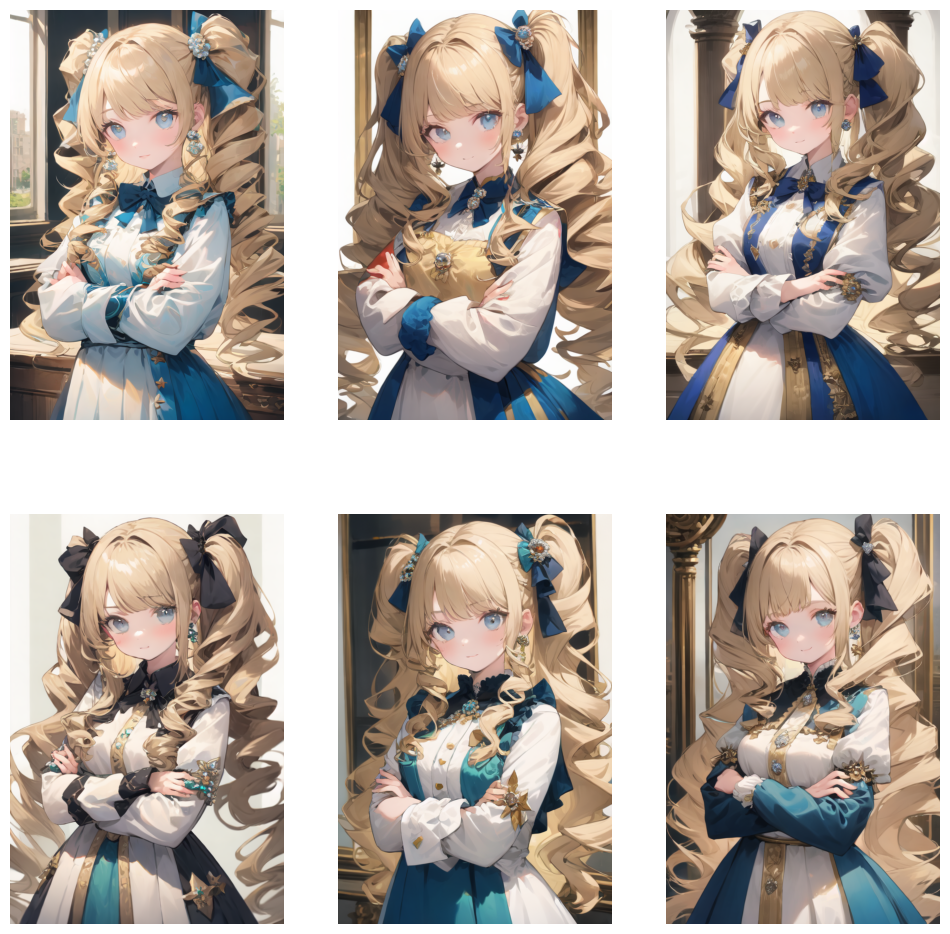

In [ ]:
pipeline.to("cuda", torch.float16)

prompt = "(masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

In [ ]:
# replace the lora/clair_sama with your own path
lora_path = os.path.join(DRIVE, f"lora/clair_sama/epoch-45-waifu-diffusion/wd-1-5-beta3-2024-02-08 14:39:02.544637")

pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")

  0%|          | 0/25 [00:00<?, ?it/s]

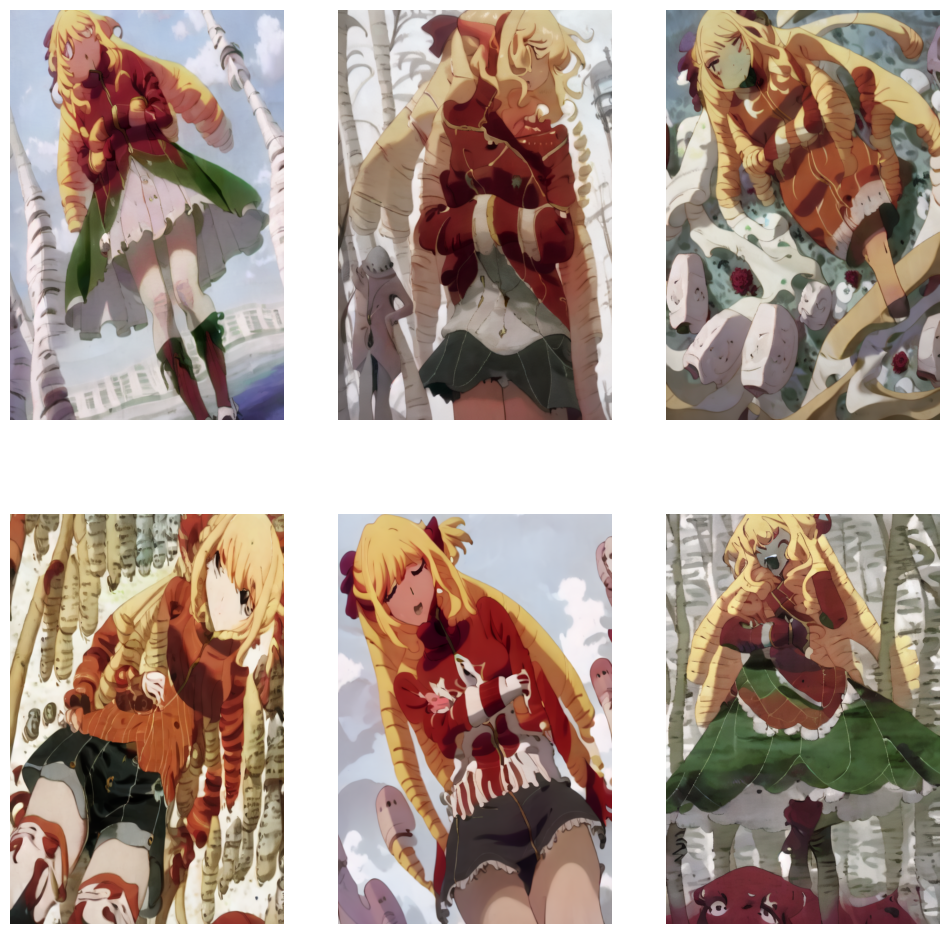

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 1.0

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

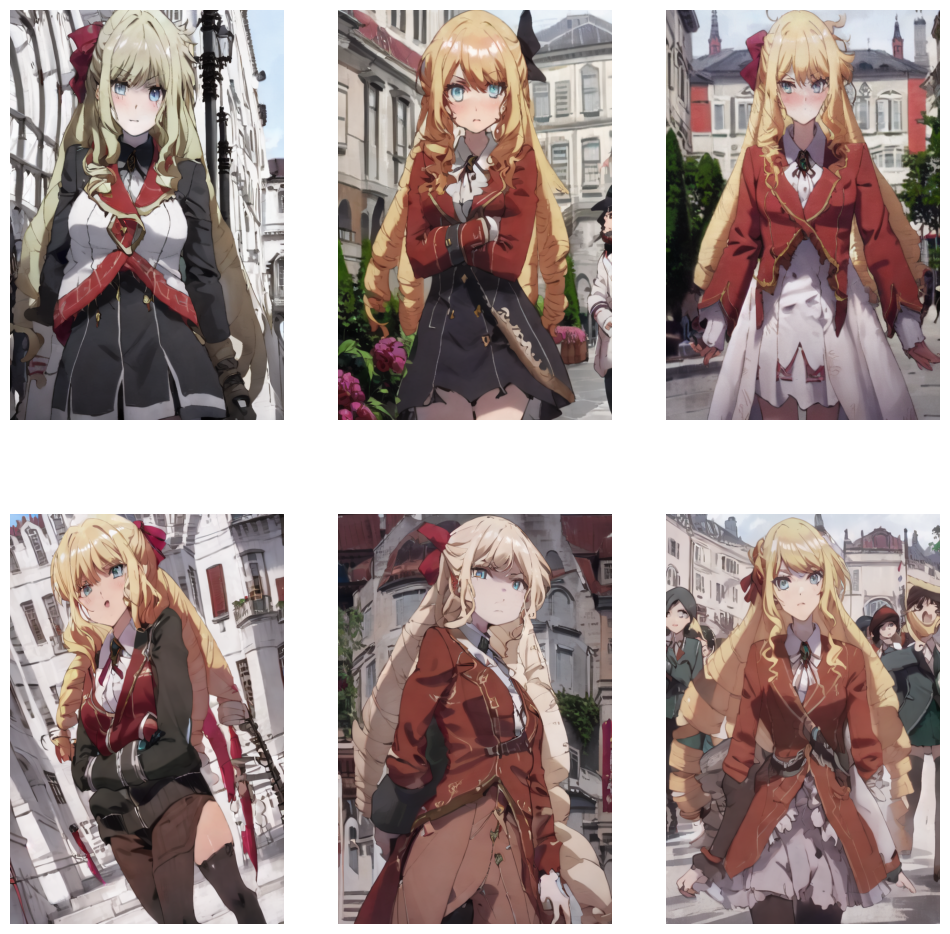

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.65

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

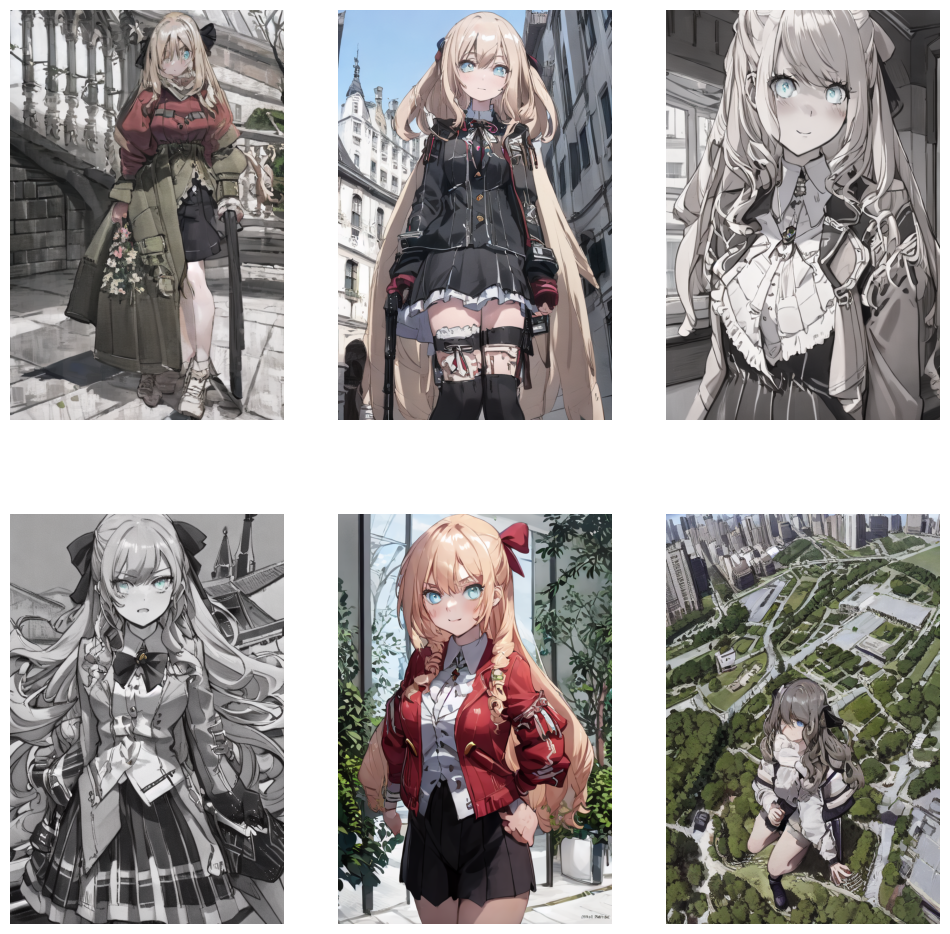

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.4

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

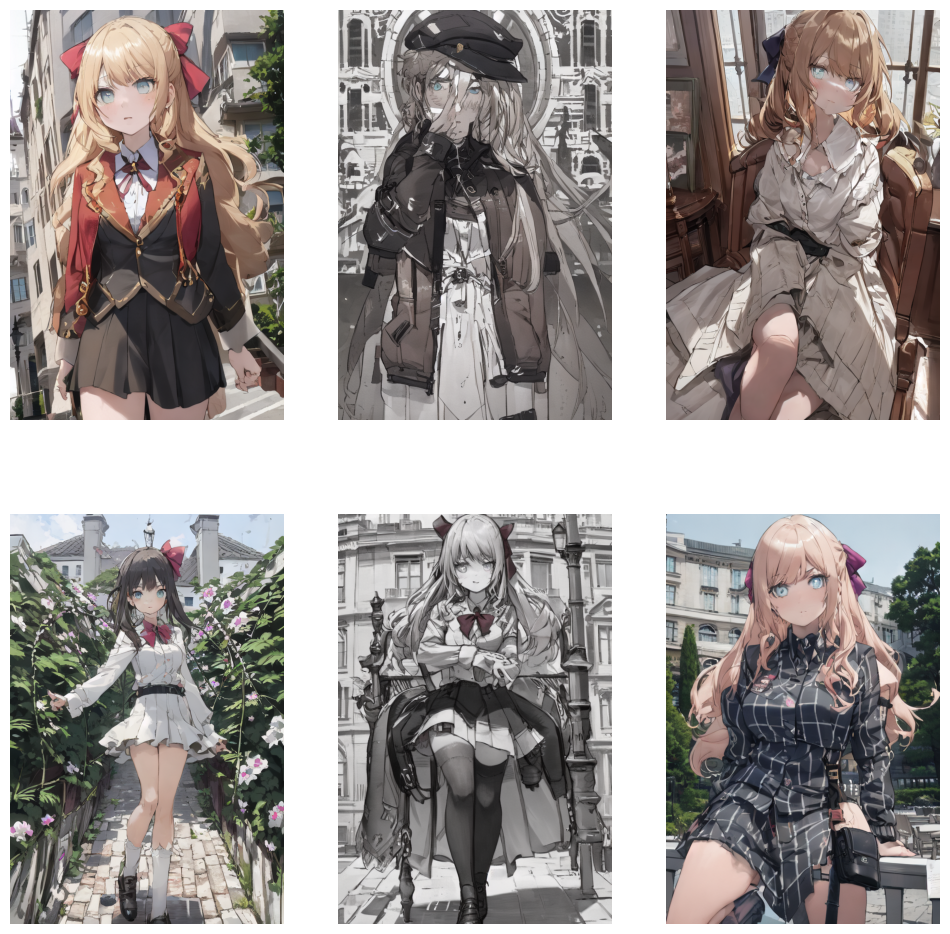

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, long hair, bow, 1girl, solo, drill hair, blue eyes, ringlets, hair bow, open mouth, twin drills, looking at viewer, brooch, upper body, smile, day, jewelry, eyebrows visible through_hair, red bow, jacket, outdoors, sky, (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.35

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

In [ ]:
torch.cuda.empty_cache()
try:
  del pipeline
except:
  print("Error: No value detected")

pipeline = StableDiffusionPipeline.from_single_file(
    "Replicant-V3.0_fp16.safetensors",
    requires_safety_checker=False,
    safety_checker=None
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

lora_path = os.path.join(DRIVE, f"lora/clair_sama/epoch-30-waifu-diffusion/wd-1-5-beta3-2024-02-08 14:35:15.411037")

pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")


  0%|          | 0/25 [00:00<?, ?it/s]

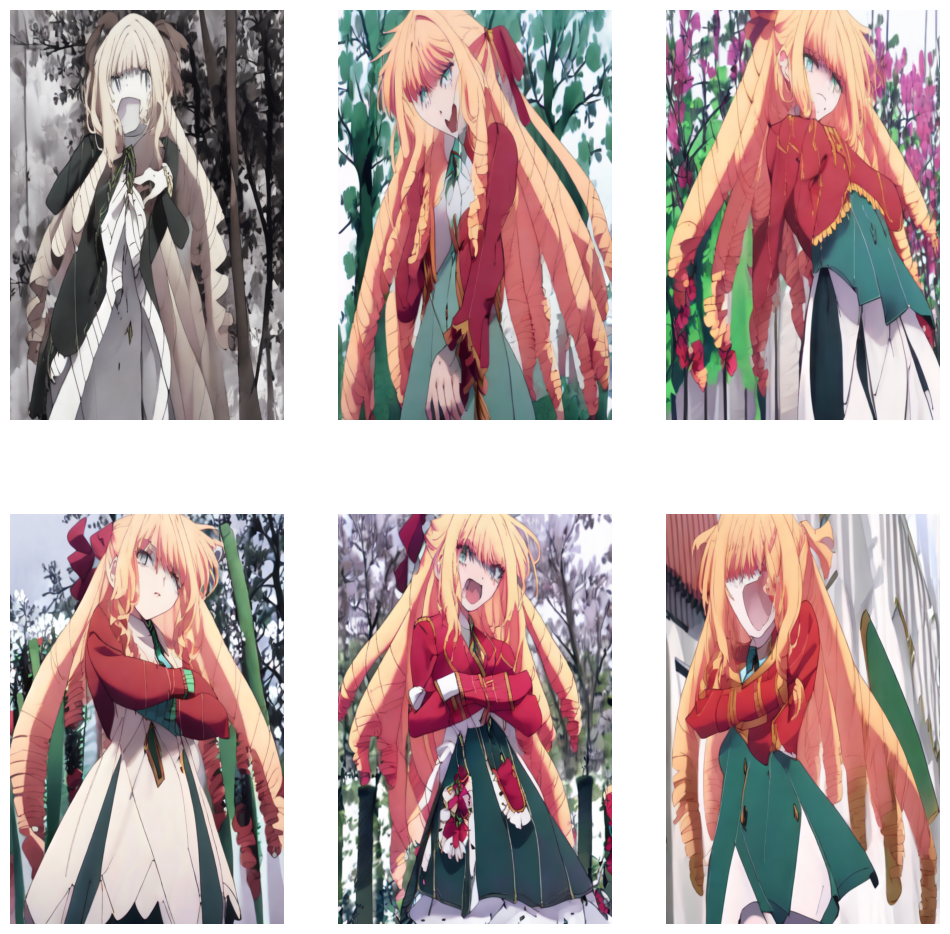

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 1.0

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

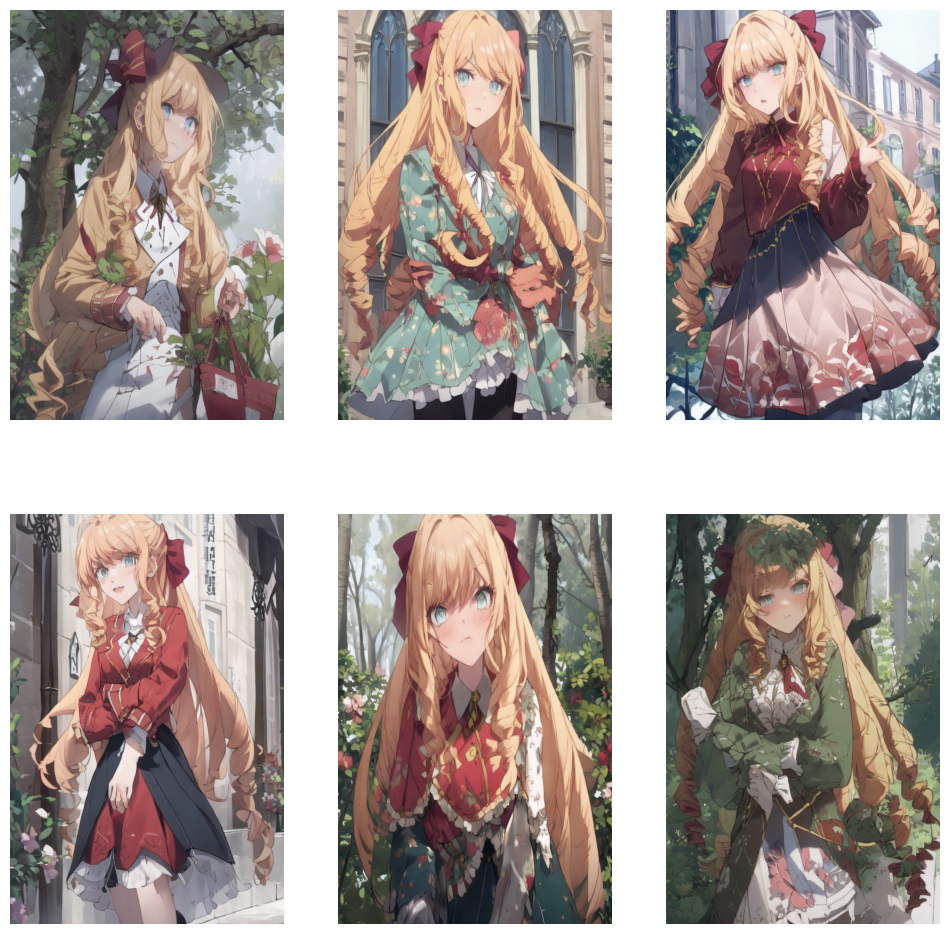

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.65

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/25 [00:00<?, ?it/s]

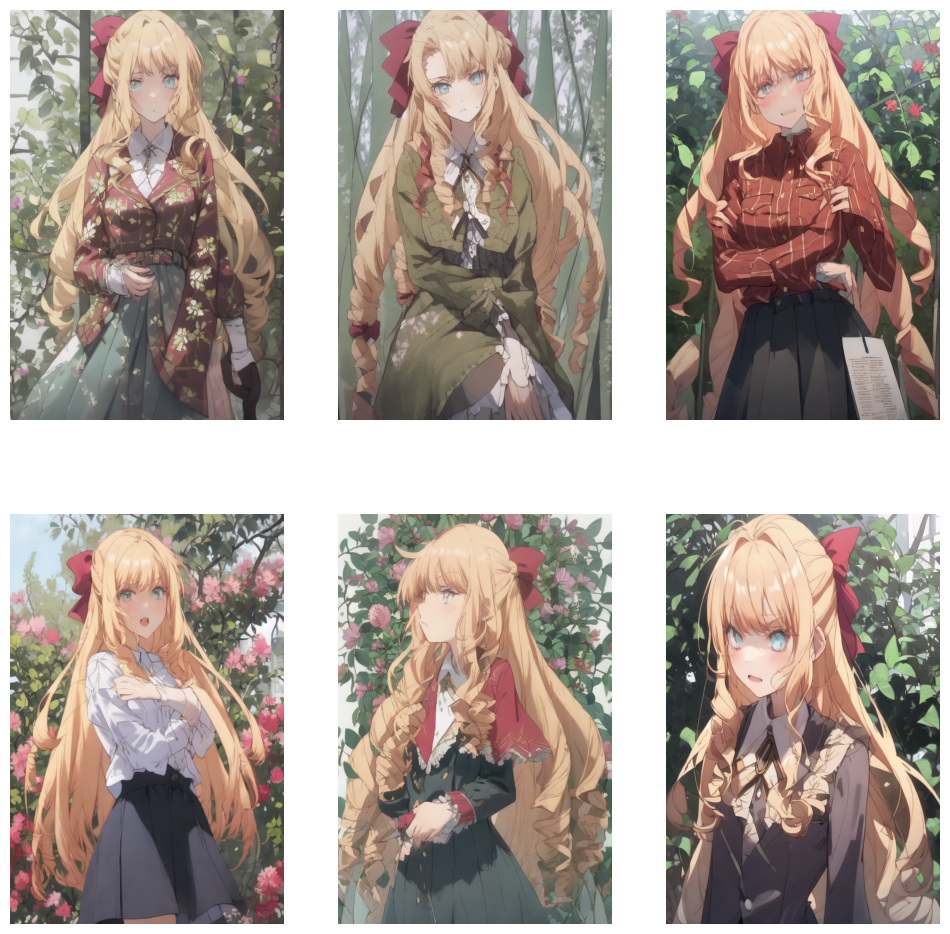

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, long hair, bow, 1girl, solo, drill hair, blue eyes, ringlets, hair bow, open mouth, twin drills, looking at viewer, brooch, upper body, smile, day, jewelry, eyebrows visible through_hair, red bow, jacket, outdoors, sky, (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.55

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=25,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

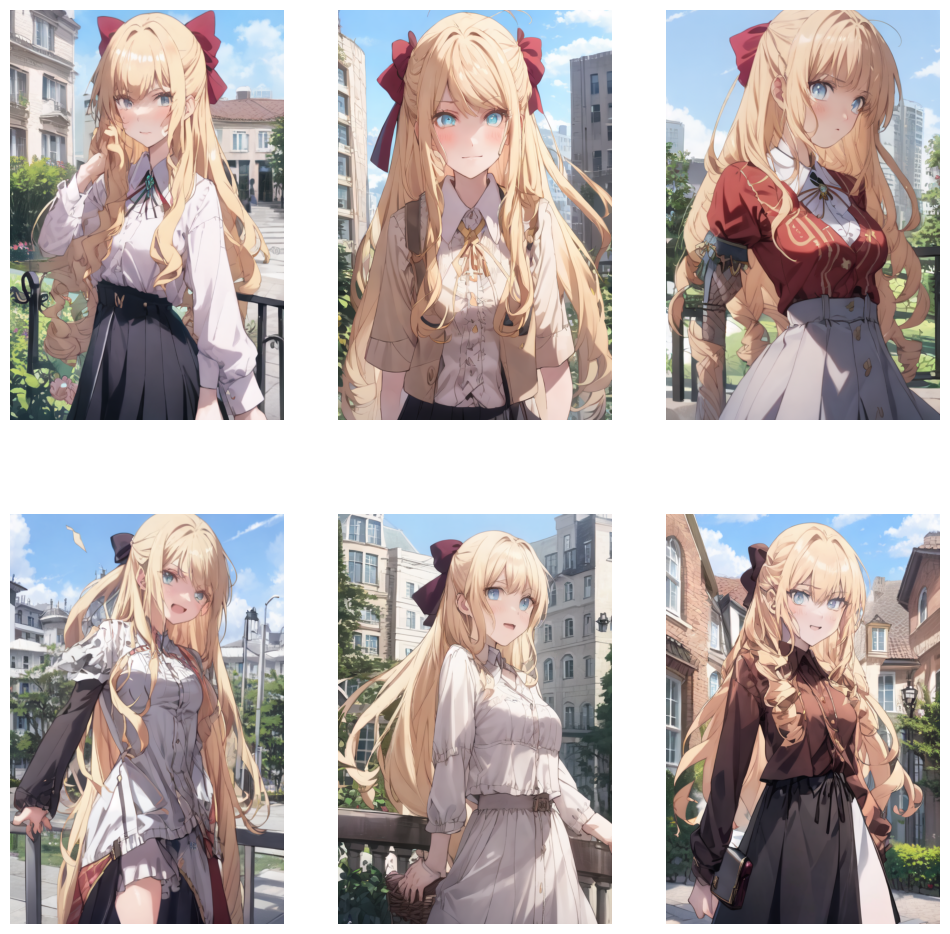

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, blue sky, bow, brooch, cloud, cloudy sky, day, drill hair, jewelry, long hair, looking at viewer, multiple girls, outdoors, red eyes, ringlets, sky, smile, twin drills, (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.45

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

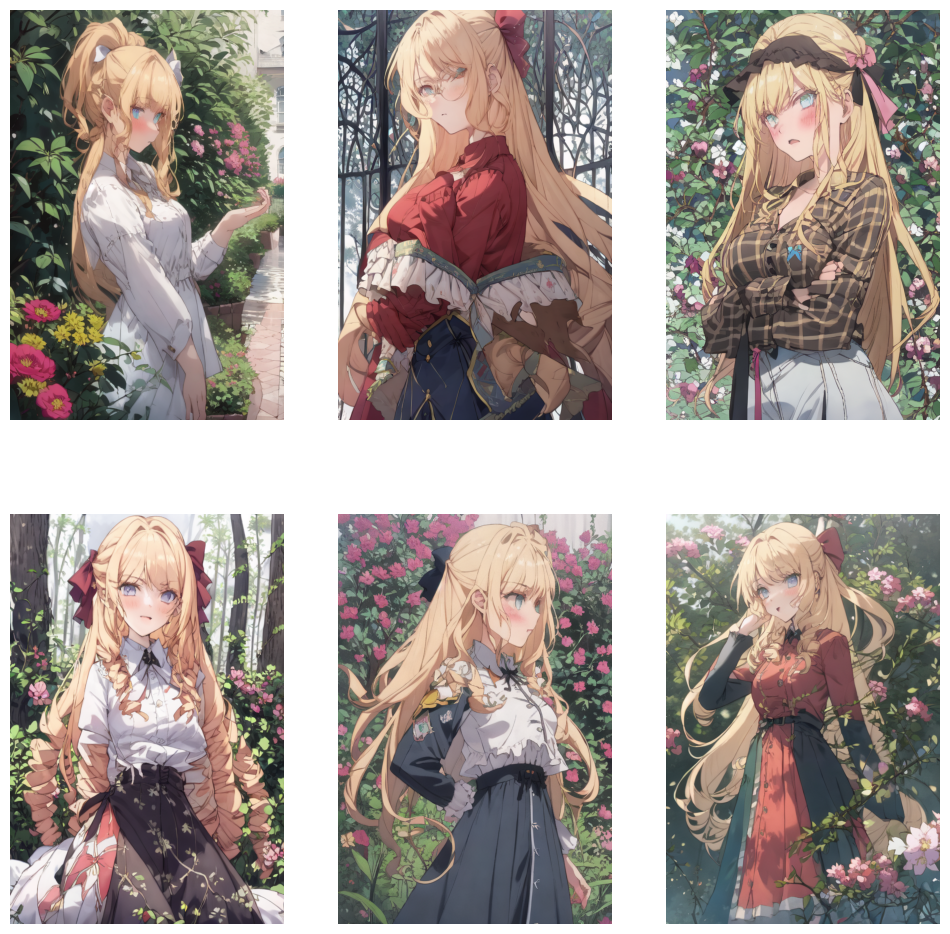

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, 1girl, blush, blonde hair, blue eyes, blue sky, blurry background, bow, brooch, building, day, jewelry, depth of field, drill hair, house, jacket, long hair, looking at viewer, outdoors, ringlets, sky, solo, tree, twin drills (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.45

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

In [5]:
torch.cuda.empty_cache()
try:
  del pipeline
except:
  print("Error: No value detected")

pipeline = StableDiffusionPipeline.from_single_file(
    "Replicant-V3.0_fp16.safetensors",
    requires_safety_checker=False,
    safety_checker=None
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

lora_path = os.path.join(DRIVE, f"lora/clair_sama/epoch-15-waifu-diffusion/wd-1-5-beta3-2024-02-08 14:31:28.759297")

pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")


Error: No value detected


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

  0%|          | 0/35 [00:00<?, ?it/s]

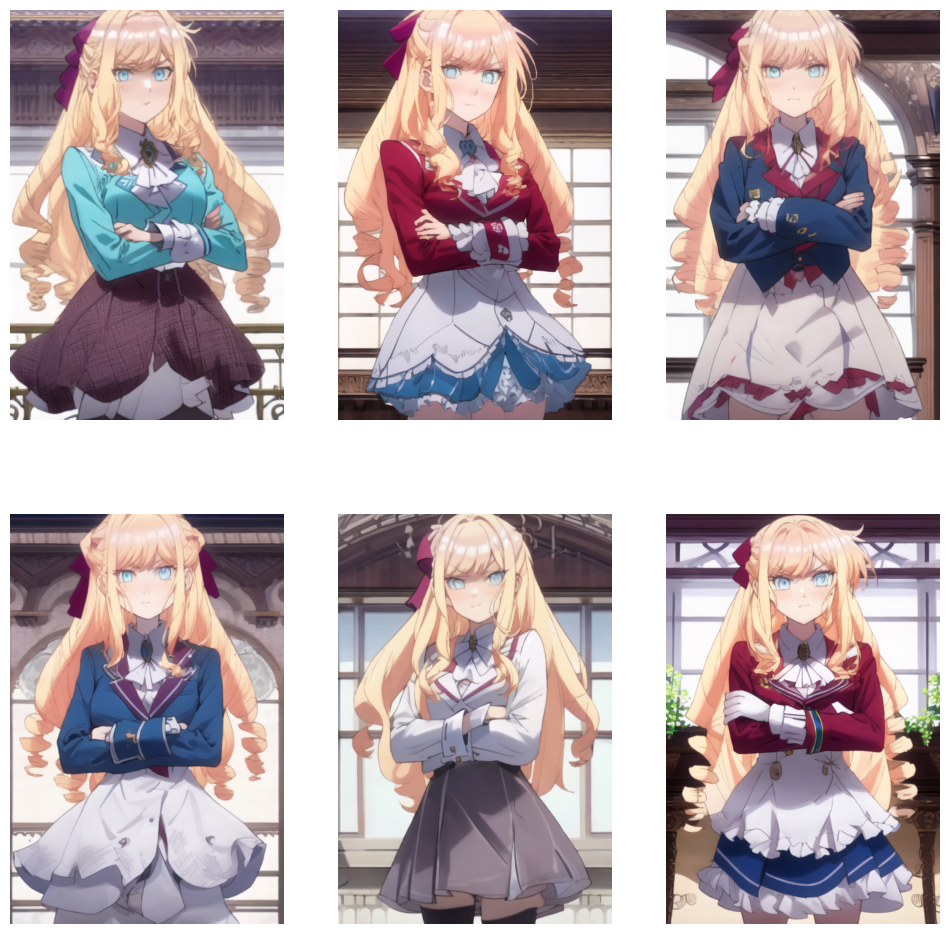

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 1.0

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

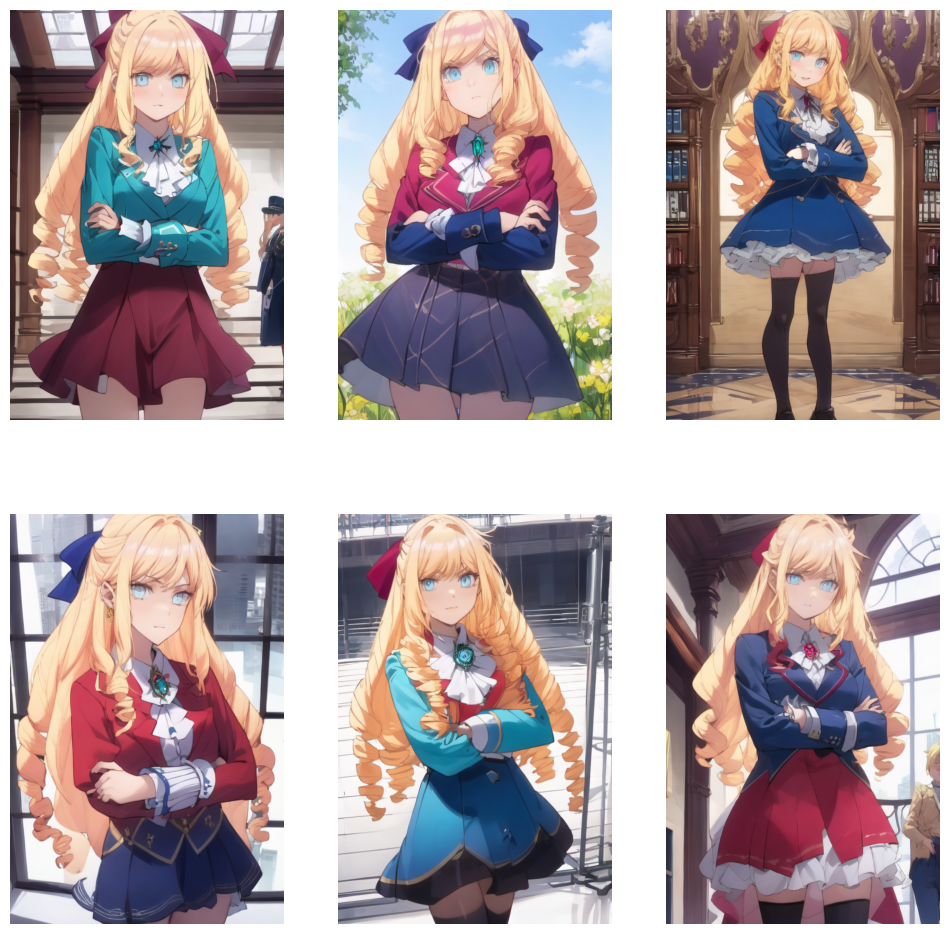

In [ ]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, (masterpiece, best quality), solo focus, 1girl, blonde hair, blue eyes, bow, brooch, crossed arms, curly hair, drill hair, hair bow, jewelry, long hair, long sleeves, looking at viewer, ringlets, side drill, solo, twin drills, very long hair"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.8

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

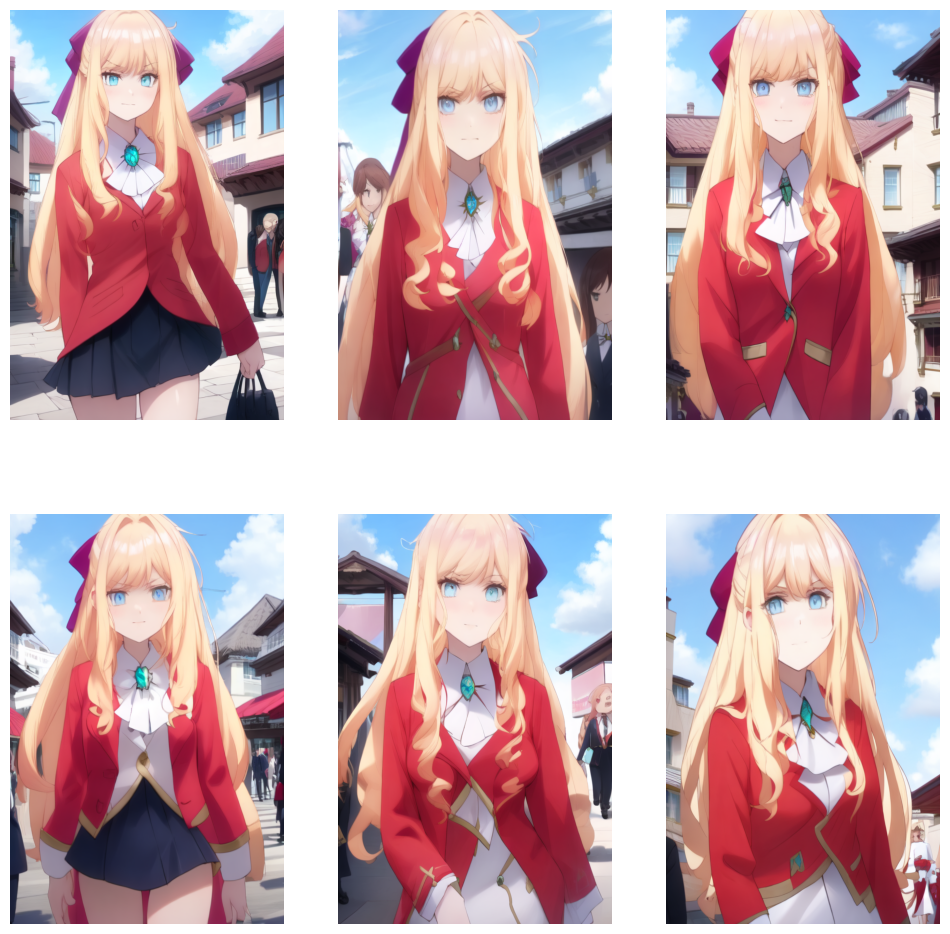

In [6]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, blue sky, bow, brooch, cloud, cloudy sky, day, drill hair, jewelry, long hair, looking at viewer, multiple girls, outdoors, red eyes, ringlets, sky, smile, twin drills, (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.9

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

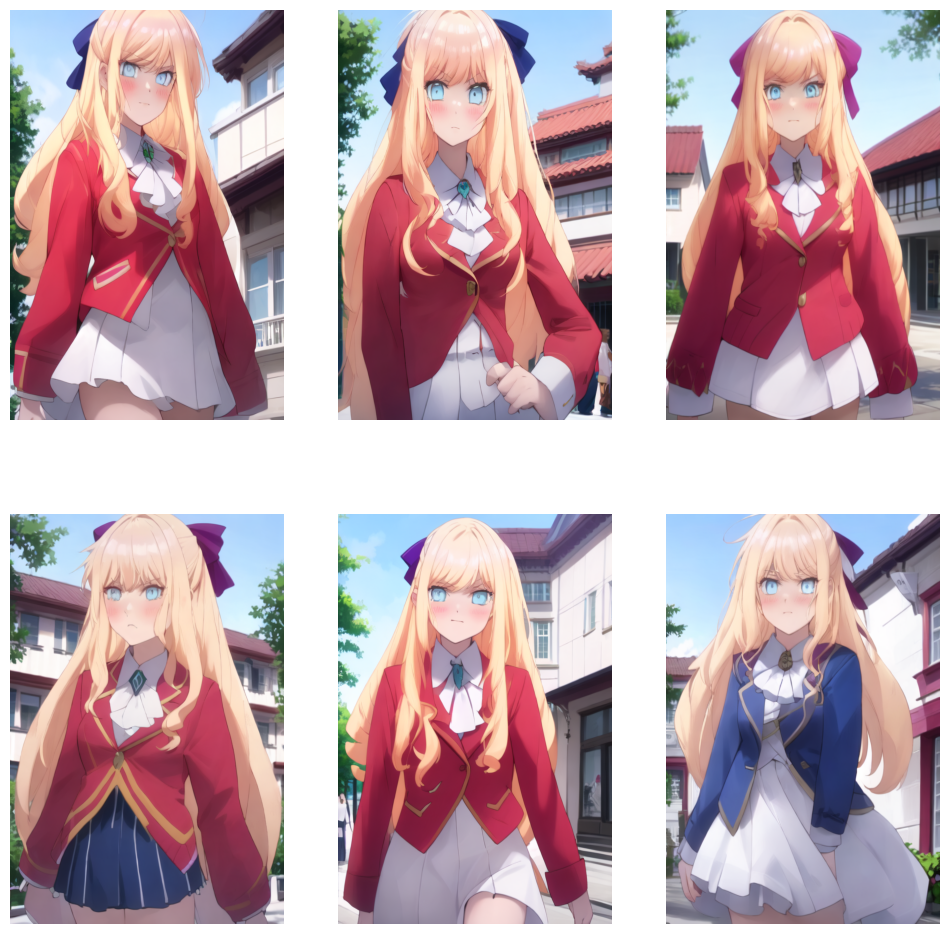

In [7]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, 1girl, blush, blonde hair, blue eyes, blue sky, blurry background, bow, brooch, building, day, jewelry, depth of field, drill hair, house, jacket, long hair, looking at viewer, outdoors, ringlets, sky, solo, tree, twin drills (masterpiece, best quality), "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.9

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

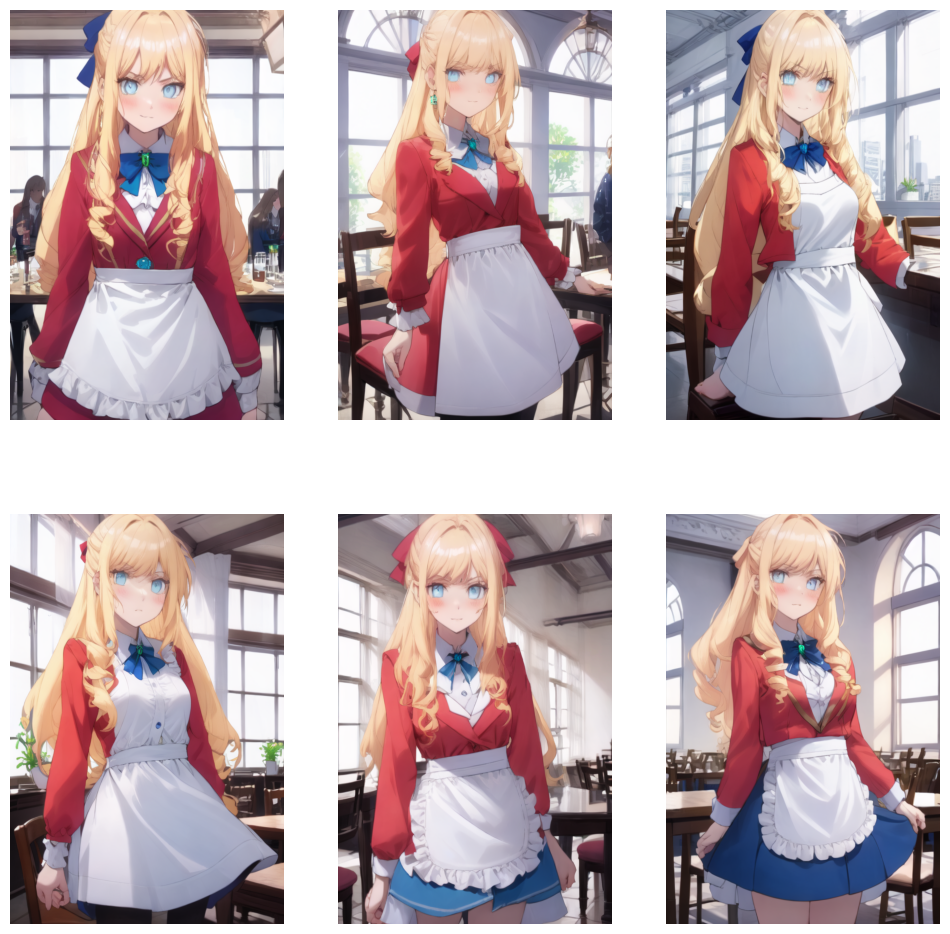

In [8]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, 1girl, blush, blonde hair, blue eyes, bow, brooch, jewelry, depth of field, drill hair, jacket, long hair, (masterpiece, best quality), solo focus, bowtie, enmaided, indoors, maid, window, maid apron, closed mouth, wrist cuffs, chair, looking at viewer, standing "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.75

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

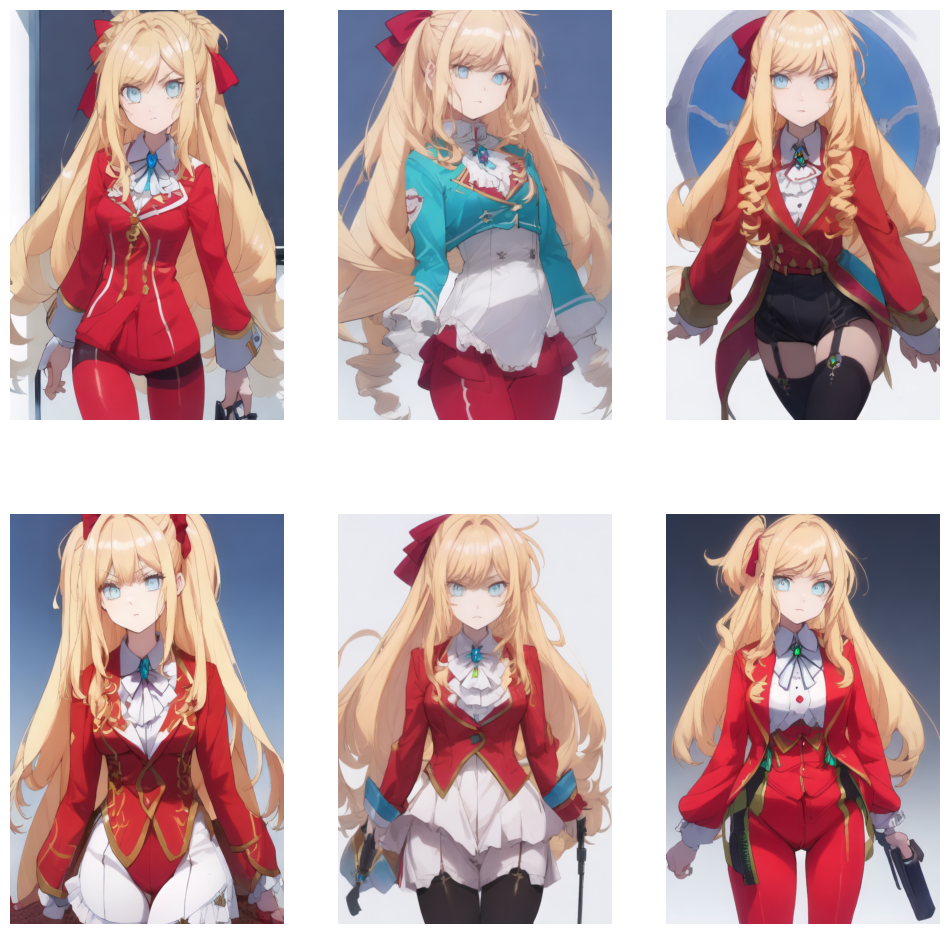

In [9]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama,  blonde hair, blue eyes, bow, drill hair, long hair, plugsuit, looking at viewer, bodysuit, breasts, bangs, absurdres, hair between eyes, hair ornament, red bodysuit, simple background, closed mouth, two side up, masterpiece, best quality, 1girl, solo "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.75

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

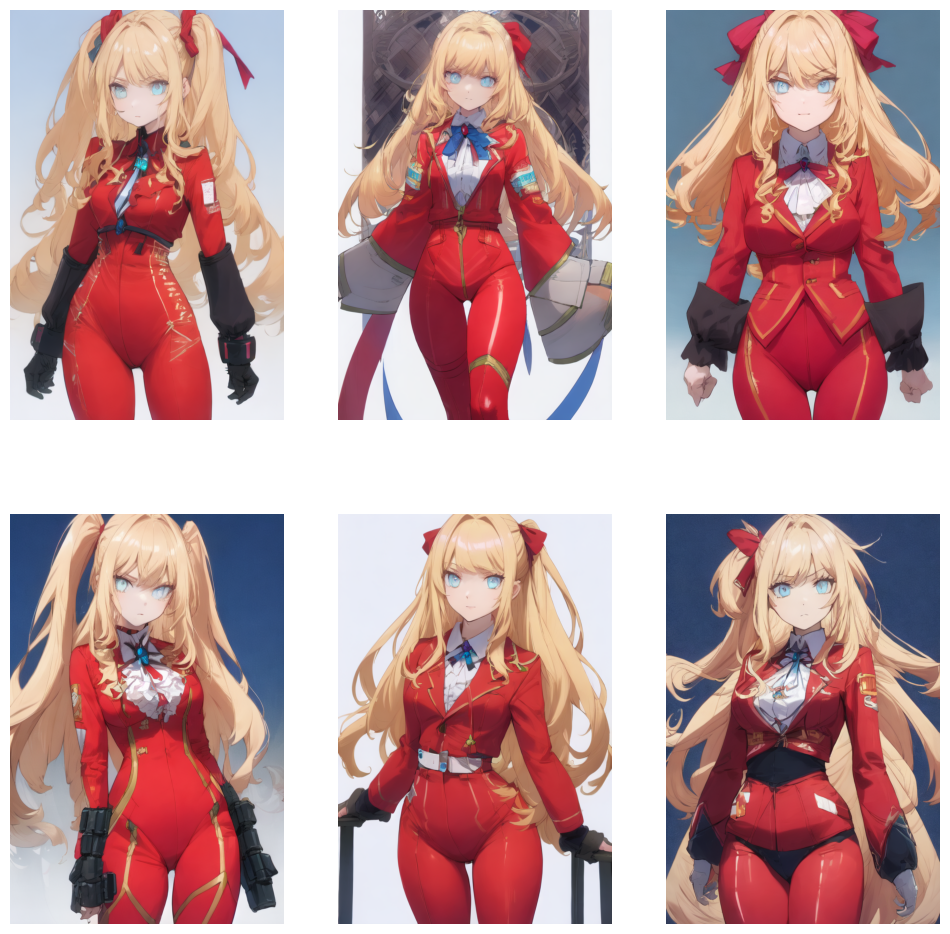

In [10]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama,  blonde hair, blue eyes, bow, drill hair, long hair, plugsuit, looking at viewer, bodysuit, breasts, bangs, absurdres, hair between eyes, hair ornament, red bodysuit, simple background, closed mouth, two side up, masterpiece, best quality, 1girl, solo "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.6

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

Token indices sequence length is longer than the specified maximum sequence length for this model (115 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['red neckwear, shirt, short sleeves, simple background, skirt, suspenders, thigh - highs, white background, white shirt, zettai ryouiki, masterpiece, best quality']


  0%|          | 0/35 [00:00<?, ?it/s]

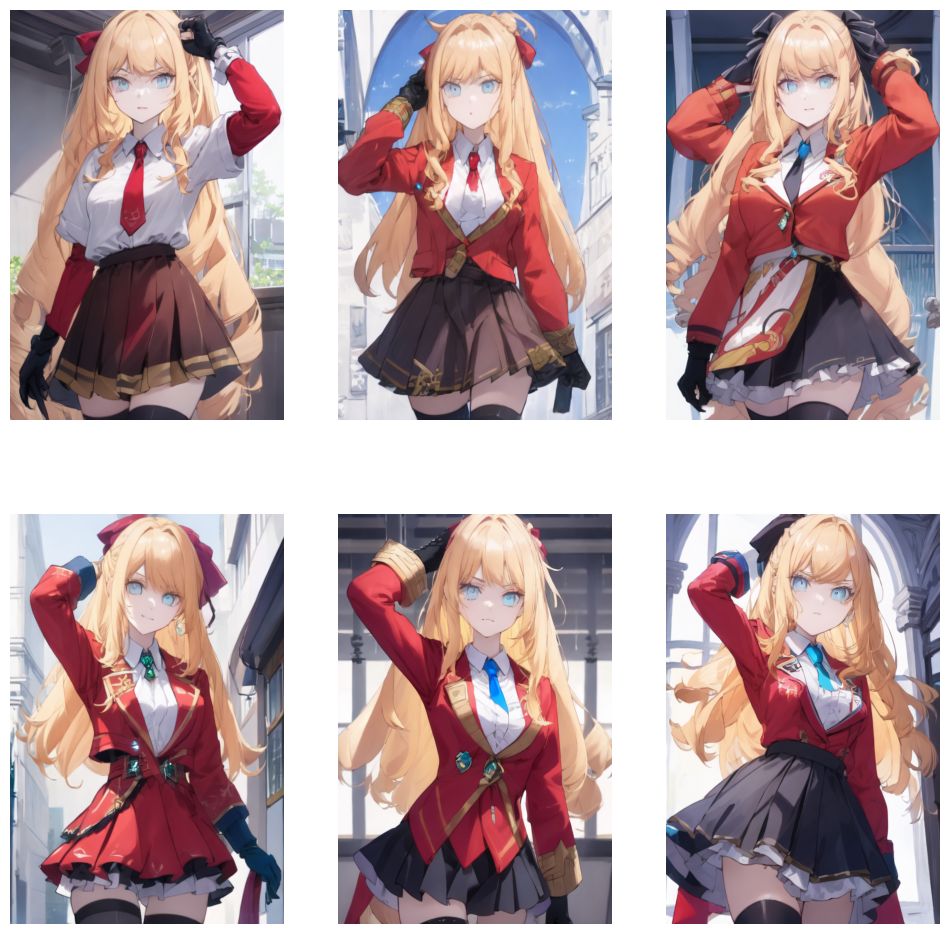

In [11]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, blue eyes, bow, drill hair, long hair, absurdres, arm up, bangs, black legwear, black skirt, breasts, collared shirt, cowboy shot, gloves, hair ornament, holding, honkai (series), honkai impact 3rd, looking at viewer, medium breasts, necktie, orange hair, red gloves, red neckwear, shirt, short sleeves, simple background, skirt, suspenders, thigh-highs, white background, white shirt, zettai ryouiki, masterpiece, best quality"
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.65

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['enders,']


  0%|          | 0/35 [00:00<?, ?it/s]

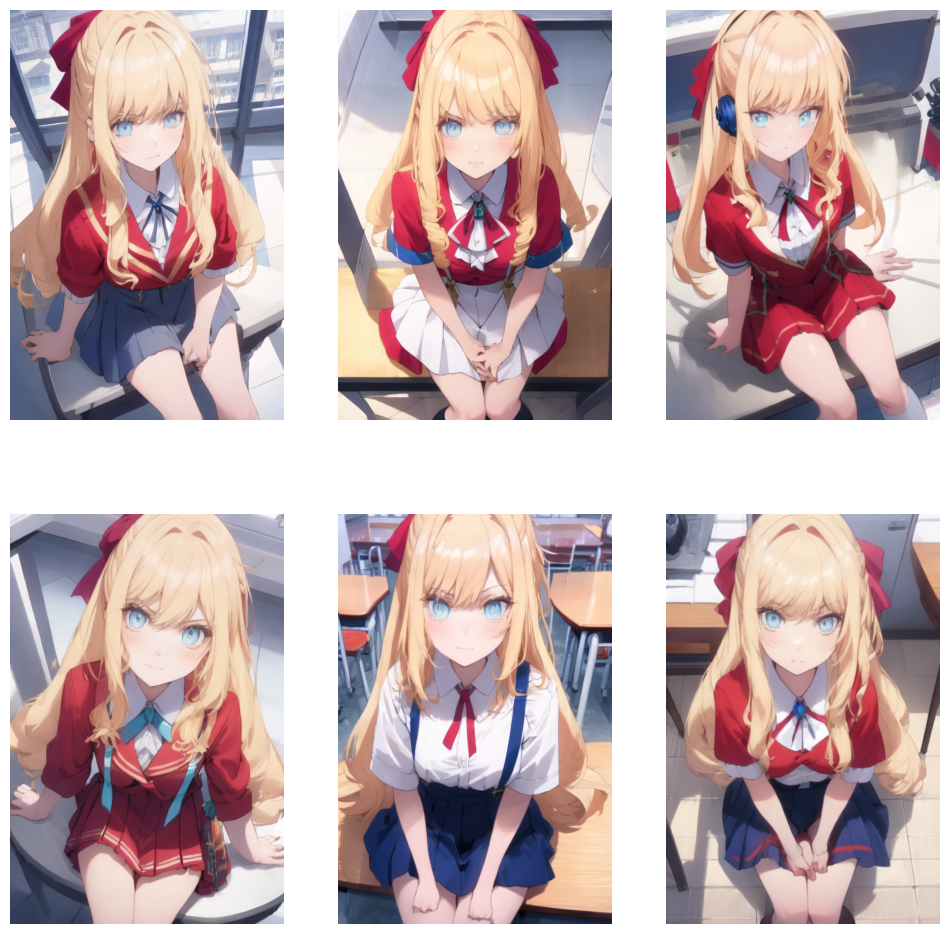

In [12]:
pipeline.to("cuda", torch.float16)
torch.cuda.empty_cache()

prompt = "ClairSama, blonde hair, blue eyes, bow, drill hair, long hair, blue skirt, closed mouth, collarbone, feet out of frame, from above, frown, hair between eyes, interface headset, looking at viewer, neck ribbon, red neckwear, ribbon, school uniform, serafuku, short sleeves, sitting, suspender skirt, suspenders, "
negative_prompt = "(low quality, worst quality:1.4), (bad anatomy), extra finger, fewer digits, jpeg artifacts,"
lora_scale = 0.7

image = pipeline(
    prompt,
    negative_prompt=negative_prompt,
    height=768,
    width=512,
    guidance_scale=10,
    num_inference_steps=35,
    num_images_per_prompt=6,
    cross_attention_kwargs={"scale": lora_scale},
).images


fig = plt.figure(figsize=(12, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.imshow(image[i])
    ax.axis("off")

plt.show()